# Project 1: Data Cleaning, Visualization, and Mining

In [1]:
# Add all of your import statements here
import numpy as np
import pandas as pd
import missingno as msno
import statsmodels.api as sm
from sklearn.datasets import fetch_mldata
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LinearRegression, Ridge, LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.svm import LinearSVC, SVC
from sklearn.decomposition import PCA
from sklearn.neural_network import MLPClassifier
import seaborn as sns
sns.set()


import matplotlib.pyplot as plt

import plotly.plotly as py
import plotly.figure_factory as ff
import plotly.offline as py
import plotly.graph_objs as go
import plotly.tools as tls
py.init_notebook_mode(connected=True)
import addfips


# ignore warnings
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

/Users/Zoe/anaconda/lib/python3.6/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


# Setup, Cleaning, Organizing, and Exploring the Data

Let's now try to read in the data, clean up the data by getting rid of NAs, and explore the data. Feel free to use any commands to do these parts. As always, report your steps in the writeup.

In [2]:
df = pd.read_csv('acs2015_county_data.csv')
af = addfips.AddFIPS()
df['StateFIPS'] = [af.get_state_fips(x) for x in df['State']]
df['CountyFIPS'] = [af.get_county_fips(x, y) for x, y in zip(df['County'], df['StateFIPS'])]
df

,CensusId,State,County,TotalPop,Men,Women,Hispanic,White,Black,Native,...,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,StateFIPS,CountyFIPS
0,1001,Alabama,Autauga,55221,26745,28476,2.6,75.8,18.5,0.4,...,1.8,26.5,23986,73.6,20.9,5.5,0.0,7.6,01,01001
1,1003,Alabama,Baldwin,195121,95314,99807,4.5,83.1,9.5,0.6,...,3.9,26.4,85953,81.5,12.3,5.8,0.4,7.5,01,01003
2,1005,Alabama,Barbour,26932,14497,12435,4.6,46.2,46.7,0.2,...,1.6,24.1,8597,71.8,20.8,7.3,0.1,17.6,01,01005
3,1007,Alabama,Bibb,22604,12073,10531,2.2,74.5,21.4,0.4,...,0.7,28.8,8294,76.8,16.1,6.7,0.4,8.3,01,01007
4,1009,Alabama,Blount,57710,28512,29198,8.6,87.9,1.5,0.3,...,2.3,34.9,22189,82.0,13.5,4.2,0.4,7.7,01,01009
5,1011,Alabama,Bullock,10678,5660,5018,4.4,22.2,70.7,1.2,...,2.8,27.5,3865,79.5,15.1,5.4,0.0,18.0,01,01011
6,1013,Alabama,Butler,20354,9502,10852,1.2,53.3,43.8,0.1,...,1.7,24.6,7813,77.4,16.2,6.2,0.2,10.9,01,01013
7,1015,Alabama,Calhoun,116648,56274,60374,3.5,73.0,20.3,0.2,...,2.7,24.1,47401,74.1,20.8,5.0,0.1,12.3,01,01015
8,1017,Alabama,Chambers,34079,16258,17821,0.4,57.3,40.3,0.2,...,2.1,25.1,13689,85.1,12.1,2.8,0.0,8.9,01,01017
9,1019,Alabama,Cherokee,26008,12975,13033,1.5,91.7,4.8,0.6,...,2.5,27.4,10155,73.1,18.5,7.9,0.5,7.9,01,01019


In [3]:
df.describe()

,CensusId,TotalPop,Men,Women,Hispanic,White,Black,Native,Asian,Pacific,...,Walk,OtherTransp,WorkAtHome,MeanCommute,Employed,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment
count,3220.000000,3.220000e+03,3.220000e+03,3.220000e+03,3220.000000,3220.000000,3220.000000,3220.000000,3220.000000,3220.000000,...,3220.000000,3220.000000,3220.000000,3220.000000,3.220000e+03,3220.000000,3220.000000,3220.000000,3220.000000,3220.000000
mean,31393.605280,9.940935e+04,4.889694e+04,5.051241e+04,11.011522,75.428789,8.665497,1.723509,1.229068,0.082733,...,3.323509,1.612733,4.631770,23.278758,4.559352e+04,74.219348,17.560870,7.931801,0.288106,8.094441
std,16292.078954,3.193055e+05,1.566813e+05,1.626620e+05,19.241380,22.932890,14.279122,7.253115,2.633079,0.734931,...,3.756096,1.670988,3.178772,5.600466,1.496995e+05,7.863188,6.510354,3.914974,0.455137,4.096114
min,1001.000000,8.500000e+01,4.200000e+01,4.300000e+01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,4.900000,6.200000e+01,25.000000,5.800000,0.000000,0.000000,0.000000
25%,19032.500000,1.121800e+04,5.637250e+03,5.572000e+03,1.900000,64.100000,0.500000,0.100000,0.200000,0.000000,...,1.400000,0.900000,2.700000,19.500000,4.550750e+03,70.500000,13.100000,5.400000,0.100000,5.500000
50%,30024.000000,2.603500e+04,1.293200e+04,1.305700e+04,3.900000,84.100000,1.900000,0.300000,0.500000,0.000000,...,2.400000,1.300000,3.900000,23.000000,1.050800e+04,75.700000,16.200000,6.900000,0.200000,7.600000
75%,46105.500000,6.643050e+04,3.299275e+04,3.348750e+04,9.825000,93.200000,9.600000,0.600000,1.200000,0.000000,...,4.000000,1.900000,5.600000,26.800000,2.863275e+04,79.700000,20.500000,9.400000,0.300000,9.900000
max,72153.000000,1.003839e+07,4.945351e+06,5.093037e+06,99.900000,99.800000,85.900000,92.100000,41.600000,35.300000,...,71.200000,39.100000,37.200000,44.000000,4.635465e+06,88.300000,66.200000,36.600000,9.800000,36.500000


In [4]:
df = df.dropna(axis=0)

# Visualizing the Data

This is the most fun part of the project! Now you can go ahead and create your graphs (appropriately labeled of course), models, and other visualizations. Make sure you demonstrate your ability to create rich graphs by creating various different types of graphs, both for numerical as well as categorical data. 

Here are some types of graphs that you will want to create for this project. Remember to browse the online documentation for many Python graphing and visualization packages such as plotly, seaborn, and matplotlib if you need to borrow any code or get some help!
1. Creating multiple graphs that plot important financial indicators (y-axis) like the median annual income, per capita income, poverty rate, childhood poverty rate, and/or unemployment rate present in a particular county AGAINST several features in the dataset (x-axis) that might affect these factors, such as the total population of the county; the racial demographics of the county; or the occupations of different workers (professionals, service workers, construction, manufacturing).   

2. Using plotly as a graphing library to visualize these financial indicators in the 2015 American Community Survey data on a geographical map of the United States on a state-wide or county-based level (similar to what we did in class when we visualized global average temperatures for different countries on a global map). 

In [5]:
total_pop = df['TotalPop']
income = df['Income']
income_per_cap = df['IncomePerCap']
child_poverty = df['ChildPoverty']
poverty = df["Poverty"]
unemployment = df['Unemployment']
county = df['County']
states = df['State']
white = df['White']

In [6]:
mean_income = []
for counties in county:
    mean_income.append(df[df['County'] == counties]['IncomePerCap'].mean())

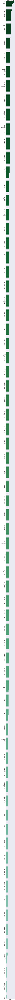

In [9]:
mean_income_bar, counties_bar = (list(x) for x in zip(*sorted(zip(mean_income, county), 
                                                             reverse = True)))
sns.set(font_scale=0.9) 
f, ax = plt.subplots(figsize=(4.5, 500))
colors_cw = sns.color_palette("BuGn_r", len(county))
sns.barplot(mean_income_bar, counties_bar, palette = colors_cw[::1])
Text = ax.set(xlabel='Average Income', title='Average Income per Capita per County')

([<matplotlib.axis.XTick at 0x221c5a5e48>,
 <a list of 2 Text xticklabel objects>)

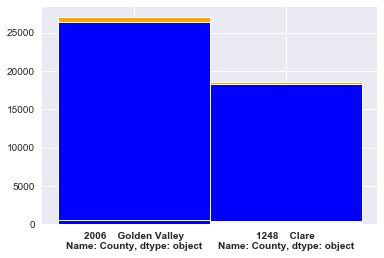

In [7]:
random_county_1 = df.sample()
random_county_2 = df.sample()

names = [random_county_1['County'], random_county_2['County']]
incomes = [random_county_1['IncomePerCap'], random_county_2['IncomePerCap']]

white_bar = [random_county_1['White'].divide(100).multiply(incomes[0]), random_county_2['White'].divide(100).multiply(incomes[1])]
black_bar = [random_county_1['Black'].divide(100).multiply(incomes[0]), random_county_2['Black'].divide(100).multiply(incomes[1])]
hispanic_bar = [random_county_1['Hispanic'].divide(100).multiply(incomes[0]), random_county_2['Hispanic'].divide(100).multiply(incomes[1])]
asian_bar = [random_county_1['Asian'].divide(100).multiply(incomes[0]), random_county_2['Asian'].divide(100).multiply(incomes[1])]
pacific_bar = [random_county_1['Pacific'].divide(100).multiply(incomes[0]), random_county_2['Pacific'].divide(100).multiply(incomes[1])]
native_bar = [random_county_1['Native'].divide(100).multiply(incomes[0]), random_county_2['Native'].divide(100).multiply(incomes[1])]

r = np.arange(1,3)


plt.bar(r, white_bar, color='blue', edgecolor = 'white', width=1, linewidth=1)
plt.bar(r, hispanic_bar, bottom=white_bar, color='orange', edgecolor = 'white',width=1, linewidth=1)
plt.bar(r, black_bar, bottom=hispanic_bar, color='black', edgecolor = 'white',width=1, linewidth=1)
plt.bar(r, native_bar, bottom=black_bar, color='green', edgecolor = 'white',width=1, linewidth=1)
plt.bar(r, asian_bar, bottom=native_bar, color='purple', edgecolor = 'white',width=1, linewidth=1)
plt.bar(r, pacific_bar, bottom=asian_bar, color='red', edgecolor = 'white',width=1, linewidth=1)


plt.xticks(r, names, fontweight='bold')

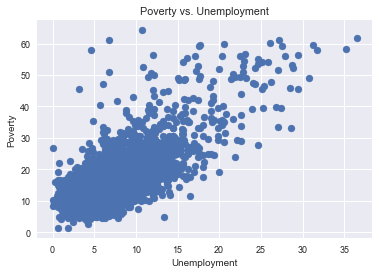

In [11]:
plt.figure()
plt.title("Poverty vs. Unemployment")
plt.xlabel("Unemployment")
plt.ylabel("Poverty")

plt.scatter(unemployment, poverty)

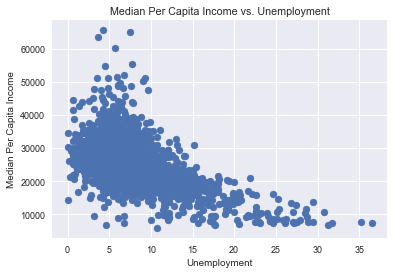

In [12]:
plt.figure()
plt.title("Median Per Capita Income vs. Unemployment")
plt.xlabel("Unemployment")
plt.ylabel("Median Per Capita Income")

plt.scatter(unemployment, income_per_cap)

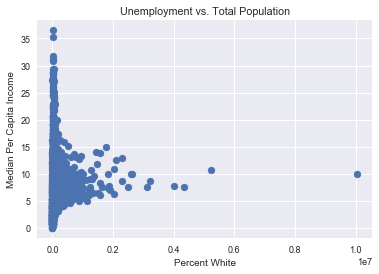

In [14]:
plt.figure()
plt.title("Unemployment vs. Total Population")
plt.xlabel("Percent White")
plt.ylabel("Median Per Capita Income")

plt.scatter(total_pop, unemployment)

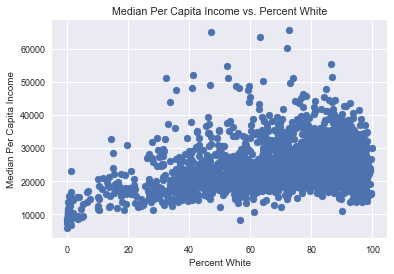

In [13]:
plt.figure()
plt.title("Median Per Capita Income vs. Percent White")
plt.xlabel("Percent White")
plt.ylabel("Median Per Capita Income")

plt.scatter(white, income_per_cap)

In [11]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 12, len(colorscale) - 1))
fips = df['CountyFIPS'].tolist()
values = df['Unemployment'].tolist()

fig = ff.create_choropleth(
    fips=fips, values=values, scope=['usa'],
    binning_endpoints=endpts, colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='USA by Unemployment',
    legend_title='unemployment %'
)
py.iplot(fig, filename='choropleth_full_usa')

In [28]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(10000, 70000, len(colorscale) - 1))
fips = df['CountyFIPS'].tolist()
values = df['Income'].tolist()

fig = ff.create_choropleth(
    fips=fips, values=values, scope=['usa'],
    binning_endpoints=endpts, colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='USA by Median Income',
    legend_title='Income in USD'
)
py.iplot(fig, filename='choropleth_full_usa')

In [27]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 30, len(colorscale) - 1))
fips = df['CountyFIPS'].tolist()
values = df['Poverty'].tolist()

fig = ff.create_choropleth(
    fips=fips, values=values, scope=['usa'],
    binning_endpoints=endpts, colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='USA by Poverty',
    legend_title='Poverty by %'
)
py.iplot(fig, filename='choropleth_full_usa')

# Linear Regression

Make sure you also demonstrate your ability to create regressions on your data. In this part of the project, you will pick 3 financial indicators (like the median annual income, per capita income, poverty rate, childhood poverty rate, and/or unemployment rate) in the dataset. You will then train 3 linear regression models in scikit-learn that attempt to predict these 3 financial indicators of a county from the rest of the data collected in the dataset. You should analyze the accuracy of your linear regression model and report important predictors or features in your dataset that had the highest effect size on these 3 financial indicators (as discovered by your regression model). 

Optional: You can try adding regularization to see if you can get better results. 

In [26]:
total_pop = df["TotalPop"]
men = df["Men"]
women = df["Women"]
hispanic = df["Hispanic"]
white = df["White"]
black = df["Black"]
native = df["Native"]
asian = df["Asian"]
pacific = df["Pacific"]
citizen = df["Citizen"]
income = df["Income"]
income_err = df["IncomeErr"]
income_per_cap = df["IncomePerCap"]
income_per_cap_err = df["IncomePerCapErr"]
poverty = df["Poverty"]
child_poverty = df["ChildPoverty"]
professional = df["Professional"]
service = df["Service"]
office = df["Office"]
construction = df["Construction"]
production = df["Production"]
drive = df["Drive"]
carpool = df["Carpool"]
transit = df["Transit"]
walk = df["Walk"]
other_transp = df["OtherTransp"]
work_at_home = df["WorkAtHome"]
mean_commute = df["MeanCommute"]
employed = df["Employed"]
private_work = df["PrivateWork"]
public_word = df["PublicWork"]
self_employed = df["SelfEmployed"]
family_work = df["FamilyWork"]
unemployment = df["Unemployment"]

The MSE for the model wage~points is: 62.6347410112


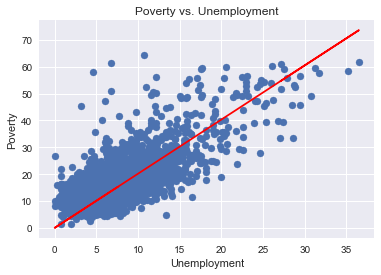

In [52]:
plt.figure()
plt.title("Poverty vs. Unemployment")
plt.xlabel("Unemployment")
plt.ylabel("Poverty")

plt.scatter(unemployment, poverty)
myOLS_points = sm.OLS(poverty, unemployment).fit()
plt.plot(unemployment, myOLS_points.predict(unemployment), color='red')

rows = int(df.shape[0] * 0.75)
poverty_train = poverty[0:rows]
poverty_valid = poverty[rows:]
unemployment_train = unemployment[0:rows]
unemployment_valid = unemployment[rows:]

myOLS = sm.OLS(poverty_train, unemployment_train).fit()
poverty_hat = myOLS.predict(unemployment_valid)
mse = np.linalg.norm(poverty_valid - poverty_hat)**2 / len(poverty_valid)

print("The MSE for the model wage~points is:", mse)